# Proyecto 2 Data Science
## Incumplimiento de Pago de Tarjeta de Credito
#### Ricardo Valenzuela
#### Sara Zavala
#### Juan Diego Solorzano

## Problema Cientifico

En los años de la pandemia, en los Estados Unidos de América, el comportamiento del uso de tarjetas de crédito ha variado bastante. El promedio de la deuda de tarjeta de crédito creció en 52% entre el 2020 y el 2019, sin embargo, este porcentaje ha caído significativamente en el 2020 (ValuePenguin) (Household Debt and Credit Report, NewYorkFed). Este proyecto pretende utilizar conceptos y metodos de Data Science para predecir que tipo de clientes tienden a caer en impago basandose en los datos disponibles en el archivo UCI_Credit_Card.

## Objetivos
Generales:
- Identificar a los tipos de clientes que pueden caer en impago

Especificos:
- Identificar que variable(s) tienen el mayor impacto en las deudas de tarjeta de credito
- Desarrollar modelos vistos en clase y predicciones sobre los clientes con deuda de tarjeta de credito 
- Identificar a que se debe el comportamiento que demuestran los porcentajes de deuda en los ultimos años

## Analisis Exploratorio Preliminar

Descripcion del dataset como estaba:

Hay 25 variables (22 cuantitativas, 3 categoricas):

- ID: ID de cada cliente
- LIMIT_BAL: cantidad del crédito otorgado en dólares NT (incluye crédito individual y familiar / suplementario
- SEX: Género (1 = masculino, 2 = femenino)
- EDUCATION: (1 = estudios de posgrado, 2 = universidad, 3 = bachillerato, 4 = otros, 5 =desconocidos, 6 = desconocidos)
- MARRIAGE: Estado civil (1 = casado, 2 = soltero, 3 = otros)
- AGE: Edad en años
- PAY_0: Estado de reembolso en septiembre de 2005 (-1 = pago debidamente, 1 = retrasoen el pago durante un mes, 2 = retraso en el pago durante dos meses,... 8 = retraso en elpago durante ocho meses, 9 = retraso en el pago durante nueve meses o más)
- PAY_2: Estado de reembolso en agosto de 2005 (escala igual a la anterior)
- PAY_3: Estado de reembolso en julio de 2005 (escala igual a la anterior)
- PAY_4: Estado de reembolso en junio de 2005 (escala igual a la anterior)
- PAY_5: Estado de reembolso en mayo de 2005 (escala igual a la anterior)
- PAY_6: Estado de reembolso en abril de 2005 (escala igual a la anterior)
- BILL_AMT1: Monto de la factura en septiembre de 2005 (dólar NT)
- BILL_AMT2: Monto de la factura en agosto de 2005 (dólar NT)
- BILL_AMT3: Monto de la factura en julio de 2005 (dólar NT)
- BILL_AMT4: Monto de la factura en junio de 2005 (dólar NT)
- BILL_AMT5: Monto de la factura en mayo de 2005 (dólar NT)
- BILL_AMT6: Monto de la factura en abril de 2005 (dólar NT)
- PAY_AMT1: Monto del pago anterior en septiembre de 2005 (dólar NT)
- PAY_AMT2: Monto del pago anterior en agosto de 2005 (dólar NT)
- PAY_AMT3: Monto del pago anterior en julio de 2005 (dólar NT)
- PAY_AMT4: Monto del pago anterior en junio de 2005 (dólar NT)
- PAY_AMT5: Monto del pago anterior en mayo de 2005 (dólar NT)
- PAY_AMT6: Monto del pago anterior en abril de 2005 (dólar NT)
- default.payment.next.month: incumplimiento de pago al mes siguiente (1 = sí, 0 = no)

In [24]:
import pandas as pd
import numpy as np
from pandas_profiling import ProfileReport
import seaborn as sn
import matplotlib.pyplot as plt

from quickda.clean_data import *
from quickda.explore_data import *
from quickda.clean_data import *

In [25]:
df = pd.read_csv("UCI_Credit_Card.csv")
df.head()

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default.payment.next.month
0,1,20000.0,2,2,1,24,2,2,-1,-1,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,4,50000.0,2,2,1,37,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,5,50000.0,1,2,1,57,-1,0,-1,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


In [26]:
explore(df, method="summarize")

,dtypes,count,null_sum,null_pct,nunique,min,25%,50%,75%,max,mean,median,std,skew
ID,int64,30000,0,0.0,30000,1.0,7500.75,15000.5,22500.25,30000.0,15000.500,15000.5,8660.398,0.000
LIMIT_BAL,float64,30000,0,0.0,81,10000.0,50000.00,140000.0,240000.00,1000000.0,167484.323,140000.0,129747.662,0.993
SEX,int64,30000,0,0.0,2,1.0,1.00,2.0,2.00,2.0,1.604,2.0,0.489,-0.424
EDUCATION,int64,30000,0,0.0,7,0.0,1.00,2.0,2.00,6.0,1.853,2.0,0.790,0.971
MARRIAGE,int64,30000,0,0.0,4,0.0,1.00,2.0,2.00,3.0,1.552,2.0,0.522,-0.019
AGE,int64,30000,0,0.0,56,21.0,28.00,34.0,41.00,79.0,35.486,34.0,9.218,0.732
PAY_0,int64,30000,0,0.0,11,-2.0,-1.00,0.0,0.00,8.0,-0.017,0.0,1.124,0.732
PAY_2,int64,30000,0,0.0,11,-2.0,-1.00,0.0,0.00,8.0,-0.134,0.0,1.197,0.791
PAY_3,int64,30000,0,0.0,11,-2.0,-1.00,0.0,0.00,8.0,-0.166,0.0,1.197,0.841
PAY_4,int64,30000,0,0.0,11,-2.0,-1.00,0.0,0.00,8.0,-0.221,0.0,1.169,1.000


In [27]:
profile = ProfileReport(df)
profile

Summarize dataset:   0%|          | 0/38 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Limpieza

### Estandarizar nombres de columnas

In [28]:
df = clean(df, method = "standardize")
df.head()

,id,limit_bal,sex,education,marriage,age,pay_0,pay_2,pay_3,pay_4,...,bill_amt4,bill_amt5,bill_amt6,pay_amt1,pay_amt2,pay_amt3,pay_amt4,pay_amt5,pay_amt6,default.payment.next.month
0,1,20000.0,2,2,1,24,2,2,-1,-1,...,0.0,0.0,0.0,0.0,689.0,0.0,0.0,0.0,0.0,1
1,2,120000.0,2,2,2,26,-1,2,0,0,...,3272.0,3455.0,3261.0,0.0,1000.0,1000.0,1000.0,0.0,2000.0,1
2,3,90000.0,2,2,2,34,0,0,0,0,...,14331.0,14948.0,15549.0,1518.0,1500.0,1000.0,1000.0,1000.0,5000.0,0
3,4,50000.0,2,2,1,37,0,0,0,0,...,28314.0,28959.0,29547.0,2000.0,2019.0,1200.0,1100.0,1069.0,1000.0,0
4,5,50000.0,1,2,1,57,-1,0,-1,0,...,20940.0,19146.0,19131.0,2000.0,36681.0,10000.0,9000.0,689.0,679.0,0


### Cambiar a tipo categorica las variables adecuadas

In [29]:
to_categoric = ["sex", "education", "marriage",
                "pay_0", "pay_2","pay_3", "pay_4", "pay_5","pay_6"]

In [30]:
df = clean(df, method = 'dtypes', columns = to_categoric, 
              dtype='category')

In [31]:
df = df.rename(columns = {'pay_0': 'pay_1',}, inplace = False)

### Revision de cambios

In [32]:
explore(df, method="summarize")

C:\Users\Zephyrus\Anaconda3\lib\site-packages\quickda\explore_data.py:26: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.

C:\Users\Zephyrus\Anaconda3\lib\site-packages\quickda\explore_data.py:30: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



,dtypes,count,null_sum,null_pct,nunique,min,25%,50%,75%,max,mean,median,std,skew
age,int64,30000,0,0.0,56,21.0,28.0,34.0,41.0,79.0,35.4855,34.0,9.217904,0.732246
bill_amt1,float64,30000,0,0.0,22723,-165580.0,3558.75,22381.5,67091.0,964511.0,51223.3309,22381.5,73635.860576,2.663861
bill_amt2,float64,30000,0,0.0,22346,-69777.0,2984.75,21200.0,64006.25,983931.0,49179.075167,21200.0,71173.768783,2.705221
bill_amt3,float64,30000,0,0.0,22026,-157264.0,2666.25,20088.5,60164.75,1664089.0,47013.1548,20088.5,69349.387427,3.08783
bill_amt4,float64,30000,0,0.0,21548,-170000.0,2326.75,19052.0,54506.0,891586.0,43262.948967,19052.0,64332.856134,2.821965
bill_amt5,float64,30000,0,0.0,21010,-81334.0,1763.0,18104.5,50190.5,927171.0,40311.400967,18104.5,60797.15577,2.87638
bill_amt6,float64,30000,0,0.0,20604,-339603.0,1256.0,17071.0,49198.25,961664.0,38871.7604,17071.0,59554.107537,2.846645
default.payment.next.month,int64,30000,0,0.0,2,0.0,0.0,0.0,0.0,1.0,0.2212,0.0,0.415062,1.343504
education,category,30000,0,0.0,7,-,-,-,-,-,-,-,-,-
id,int64,30000,0,0.0,30000,1.0,7500.75,15000.5,22500.25,30000.0,15000.5,15000.5,8660.398374,0.0


### Eliminando columna de Id

In [33]:
df = clean(df, method = 'dropcols', columns = ['id'])

### Cambiando a solo un valor desconocido los valores 0,5,6 de educacion

In [34]:
df = clean(df, method = "replaceval",       
            columns = ["education"],
            to_replace = [0,5,6],
            value = 5)

### Cambiando el valor 0 a 3 (otros) en marrige

In [35]:
df = clean(df, method = "replaceval",       
            columns = ["marriage"],
            to_replace = [0],
            value = 3)

### Aclaracion sobre los valores -2 y 0 de las columans pay
Estos valores si tienen un significato en el dataset con respecto a la realizacion de los pagos por lo que no se pueden modificar a nulo.

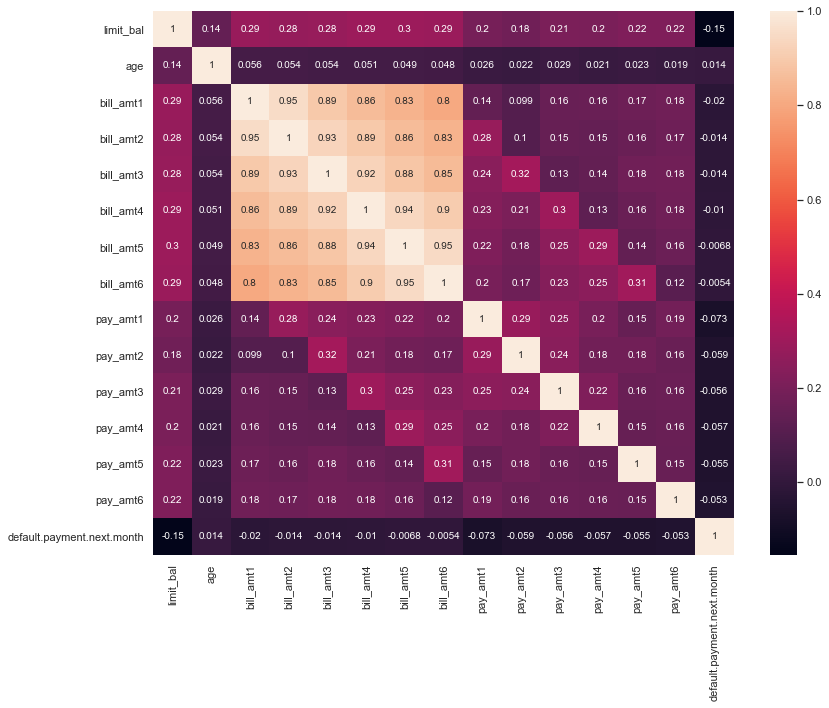

In [36]:
correlation = df.corr()
plt.figure(figsize = (13, 10))
sn.heatmap(correlation, annot=True)
plt.show()

### Obtener columna de bill_amt con valores promediados

In [37]:
dfSimp = df

In [38]:
promedio = (dfSimp["bill_amt1"]+dfSimp["bill_amt2"]+dfSimp["bill_amt3"]
            +dfSimp["bill_amt4"]+dfSimp["bill_amt5"]+dfSimp["bill_amt6"])/6
dfSimp["prom_bill_amt"] = promedio

In [39]:
dfSimp = clean(dfSimp, method = 'dropcols', columns = ['bill_amt1',"bill_amt2","bill_amt3","bill_amt4","bill_amt5","bill_amt6"])

### Cambiando de orden columnas

In [40]:
cols = ['limit_bal', 'sex','education','marriage','age','pay_1','pay_2','pay_3',
        'pay_4','pay_5','pay_6','prom_bill_amt','pay_amt1','pay_amt2','pay_amt3','pay_amt4','pay_amt5',
        'pay_amt6','default.payment.next.month']

In [41]:
dfSimp = dfSimp[cols]

### Analizar nuevo dataset 

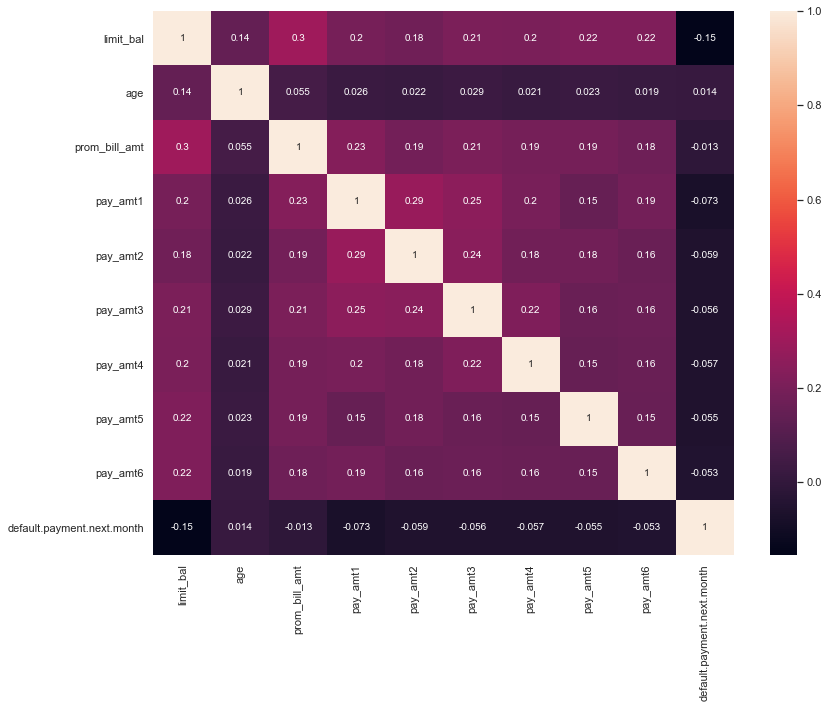

In [43]:
correlation = dfSimp.corr()
plt.figure(figsize = (13, 10))
sn.heatmap(correlation, annot=True)
plt.show()

In [44]:
explore(dfSimp, method="summarize")

C:\Users\Zephyrus\Anaconda3\lib\site-packages\quickda\explore_data.py:26: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.

C:\Users\Zephyrus\Anaconda3\lib\site-packages\quickda\explore_data.py:30: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



,dtypes,count,null_sum,null_pct,nunique,min,25%,50%,75%,max,mean,median,std,skew
age,int64,30000,0,0.0,56,21.0,28.0,34.0,41.0,79.0,35.4855,34.0,9.217904,0.732246
default.payment.next.month,int64,30000,0,0.0,2,0.0,0.0,0.0,0.0,1.0,0.2212,0.0,0.415062,1.343504
education,category,30000,0,0.0,5,-,-,-,-,-,-,-,-,-
limit_bal,float64,30000,0,0.0,81,10000.0,50000.0,140000.0,240000.0,1000000.0,167484.322667,140000.0,129747.661567,0.992867
marriage,category,30000,0,0.0,3,-,-,-,-,-,-,-,-,-
pay_1,category,30000,0,0.0,11,-,-,-,-,-,-,-,-,-
pay_2,category,30000,0,0.0,11,-,-,-,-,-,-,-,-,-
pay_3,category,30000,0,0.0,11,-,-,-,-,-,-,-,-,-
pay_4,category,30000,0,0.0,11,-,-,-,-,-,-,-,-,-
pay_5,category,30000,0,0.0,10,-,-,-,-,-,-,-,-,-


### Representacion visual de datos cuantitativos

array([[<AxesSubplot:title={'center':'limit_bal'}>,
        <AxesSubplot:title={'center':'age'}>,
        <AxesSubplot:title={'center':'prom_bill_amt'}>],
       [<AxesSubplot:title={'center':'pay_amt1'}>,
        <AxesSubplot:title={'center':'pay_amt2'}>,
        <AxesSubplot:title={'center':'pay_amt3'}>],
       [<AxesSubplot:title={'center':'pay_amt4'}>,
        <AxesSubplot:title={'center':'pay_amt5'}>,
        <AxesSubplot:title={'center':'pay_amt6'}>],
       [<AxesSubplot:title={'center':'default.payment.next.month'}>,
        <AxesSubplot:>, <AxesSubplot:>]], dtype=object)

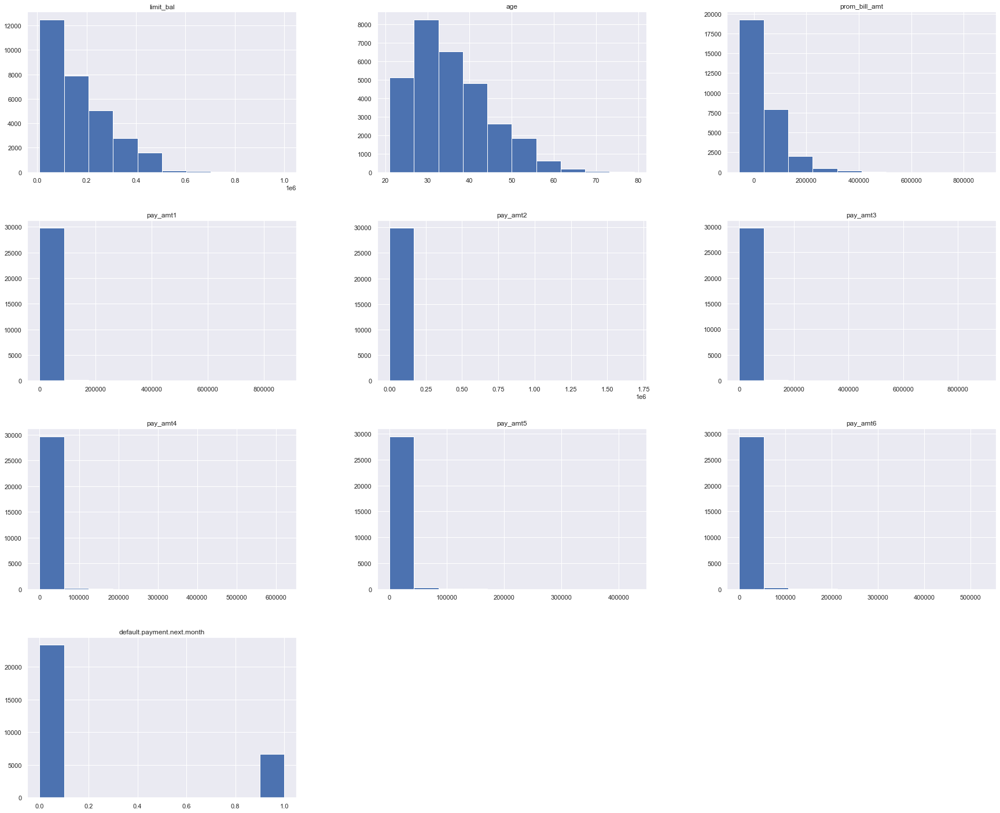

In [45]:
#Creacion de graficas para visualizar cada columna del dataset
dfSimp.hist(figsize=(30, 25))

### Visualizacion datos categoricos

<AxesSubplot:title={'center':'Educacion'}>

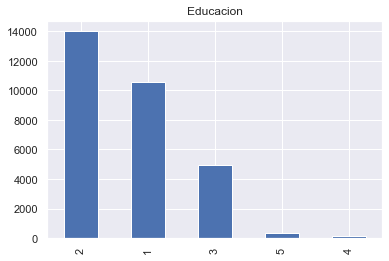

In [48]:
dfSimp['education'].value_counts().plot(kind='bar', title = "Educacion")

<AxesSubplot:title={'center':'Estado civil'}>

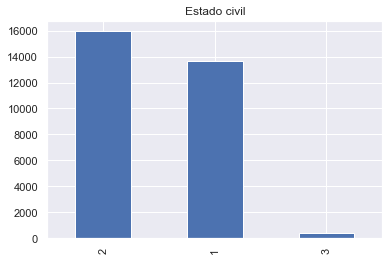

In [50]:
dfSimp['marriage'].value_counts().plot(kind='bar', title = "Estado civil")

<AxesSubplot:title={'center':'Sexo'}>

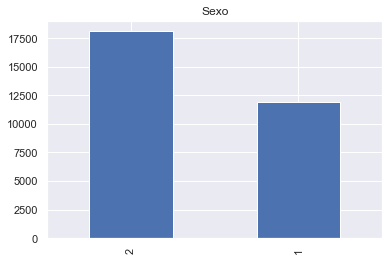

In [51]:
dfSimp['sex'].value_counts().plot(kind='bar', title = "Sexo")

### Cruce de variables

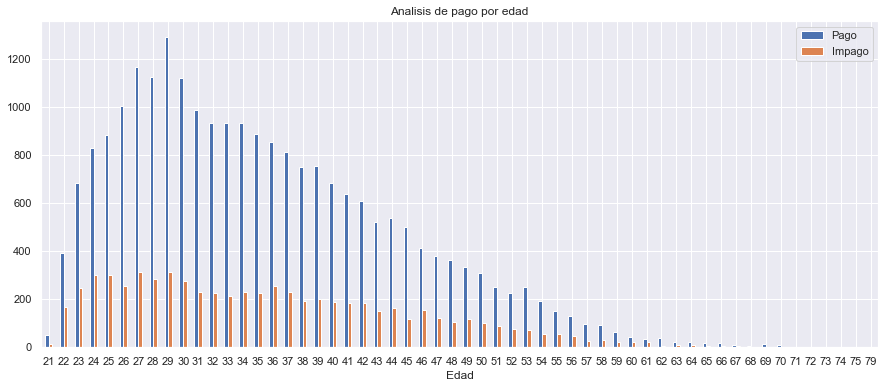

In [54]:
pd.crosstab(dfSimp.age, dfSimp['default.payment.next.month']).plot(kind="bar",figsize=(15,6), title = "Analisis de pago por edad")
plt.xlabel('Edad')
plt.xticks(rotation=0)
plt.legend(["Pago", "Impago"])
plt.show()

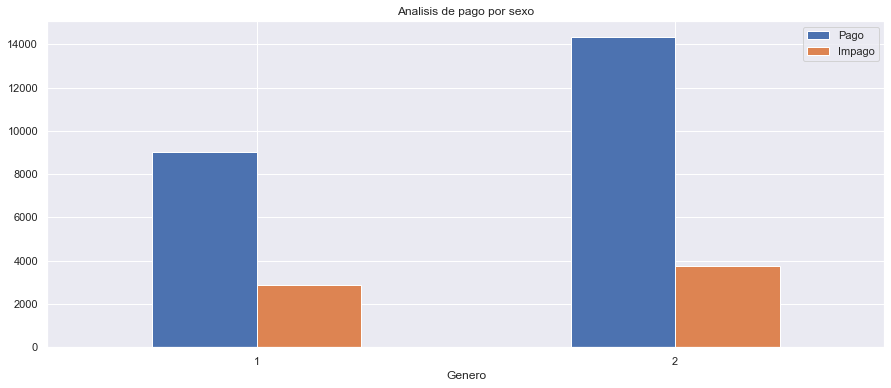

In [56]:
pd.crosstab(dfSimp.sex, dfSimp['default.payment.next.month']).plot(kind="bar",figsize=(15,6), title = "Analisis de pago por sexo")
plt.xlabel('Genero')
plt.xticks(rotation=0)
plt.legend(["Pago", "Impago"])
plt.show()

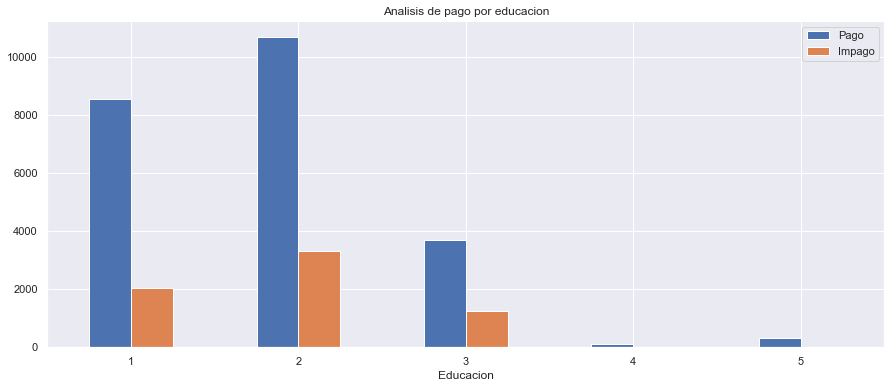

In [58]:
pd.crosstab(dfSimp.education, dfSimp['default.payment.next.month']).plot(kind="bar",figsize=(15,6), title = "Analisis de pago por educacion")
plt.xlabel('Educacion')
plt.xticks(rotation=0)
plt.legend(["Pago", "Impago"])
plt.show()

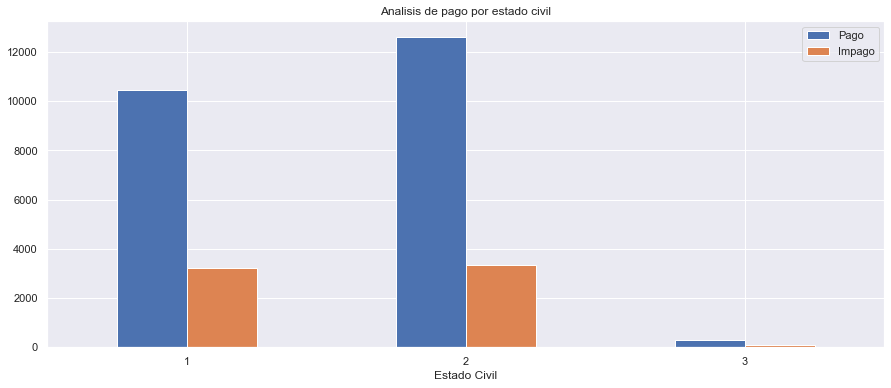

In [59]:
pd.crosstab(dfSimp.marriage, dfSimp['default.payment.next.month']).plot(kind="bar",figsize=(15,6),title = "Analisis de pago por estado civil")
plt.xlabel('Estado Civil')
plt.xticks(rotation=0)
plt.legend(["Pago", "Impago"])
plt.show()

### Correlacion 

In [60]:
correlation = dfSimp.corr()

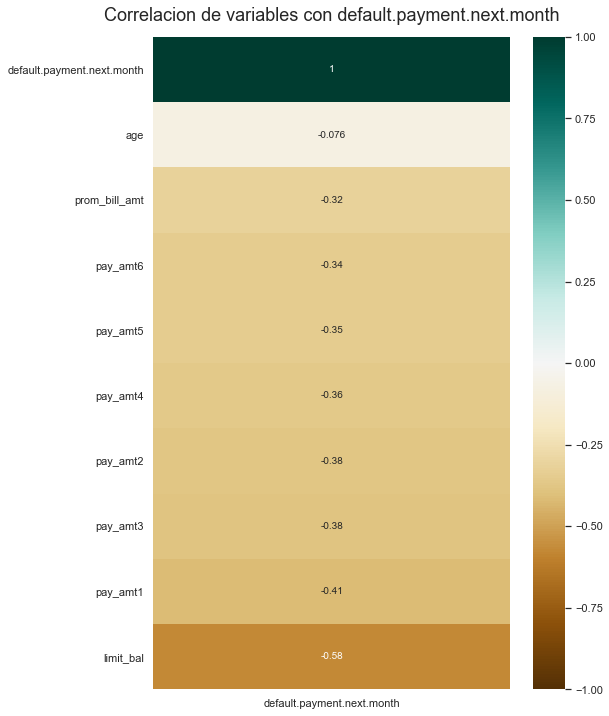

In [61]:
plt.figure(figsize=(8, 12))
heatmap = sn.heatmap(correlation.corr()[['default.payment.next.month']].sort_values(by='default.payment.next.month', ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlacion de variables con default.payment.next.month', fontdict={'fontsize':18}, pad=16);